# Task 1

In [1]:
# Importing required libraries
from diffusers import StableDiffusionControlNetPipeline, ControlNetModel, UniPCMultistepScheduler
from controlnet_aux import HEDdetector, NormalBaeDetector, CannyDetector, MidasDetector
import numpy as np
import torch
import cv2
from PIL import Image
import time
import os

c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\controlnet_aux\mediapipe_face\mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\controlnet_aux\segment_anything\modeling\tiny_vit_sam.py:654: UserWarning: Overwriting tiny_vit_5m_224 in registry with controlnet_aux.segment_anything.modeling.tiny_vit_sam.tiny_vit_5m_224. This is because the name being registered conflicts with an existing name. Please check if this is not expected.
  return register_model(fn_wrapper)
c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\controlnet_aux\segment_anything\modeling\tiny_vit_sam.py:654: UserWarning: Overwriting tiny_vit_11m_224 in registry with controlnet_aux.segment_anything.modeling.tiny_vit_sam.tiny_vit_11m_224. This is becau

In [2]:
# Selecting cpu or cuda for operations
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [3]:
# Initializing the prompt list from the prompts in the "Metadata/prompts.docx"
prompt_list = ["beautiful landscape, mountains in the background","luxury bedroom interior","Beautiful snowy mountains",
               "luxurious bedroom interior","walls with cupboard","room with chair","House in the forest"]

In [4]:
# Function to load depth images from the "Metadata/Images" folder
def load_depth_img(idx):
    depth_image_base_path = "Metadata/Images/"
    if (idx == 5 or idx == 6):
        path = depth_image_base_path + str(idx+1) +".npy"
        depth_image = np.load(path)
        depth_image = depth_image.astype(np.uint8)
        return Image.fromarray(depth_image)
    else:
        path = depth_image_base_path + str(idx+1) +".png"
        depth_image = Image.open(path)
        depth_img = np.array(depth_image).astype(np.uint8)
        return Image.fromarray(depth_img)

In [5]:
# Function to load depth image from a specified path
def load_depth_img_from_path(path):
    depth_image = Image.open(path)
    depth_img = np.array(depth_image).astype(np.uint8)
    return Image.fromarray(depth_img)

In [6]:
# selecting the ControlNet model version.
# if controlnet_models_select = 0 then ControlNet v1.1 is used else v1.0
controlnet_models_select = 0

if (controlnet_models_select == 0):
    controlnet_depth = ControlNetModel.from_pretrained("lllyasviel/control_v11f1p_sd15_depth", torch_dtype=torch.float16)
    controlnet_canny = ControlNetModel.from_pretrained("lllyasviel/control_v11p_sd15_canny",torch_dtype=torch.float16)
    controlnet_normal = ControlNetModel.from_pretrained("lllyasviel/control_v11p_sd15_normalbae",torch_dtype=torch.float16)
    controlnet_hed = ControlNetModel.from_pretrained("lllyasviel/control_v11p_sd15_softedge",torch_dtype=torch.float16)
elif (controlnet_models_select == 1):
    controlnet_depth = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-depth", torch_dtype=torch.float16)
    controlnet_canny = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-canny",torch_dtype=torch.float16)
    controlnet_normal = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-normal",torch_dtype=torch.float16)
    controlnet_hed = ControlNetModel.from_pretrained("lllyasviel/sd-controlnet-hed",torch_dtype=torch.float16)

In [7]:
# Initializing the dictionary to hold different combination of controlnet models
controlnet_model_dict= {
    "depth" : controlnet_depth,
    "depth_hed" : [controlnet_depth,controlnet_hed],
    "depth_canny" : [controlnet_depth,controlnet_canny],
    "depth_normal" : [controlnet_depth,controlnet_normal],
    "depth_hed_normal" : [controlnet_depth,controlnet_hed,controlnet_normal],
    "depth_canny_normal" : [controlnet_depth,controlnet_canny,controlnet_normal]
}

In [8]:
# Function to create the Stable Diffusion pipeline
def create_pipeline(controlnet_models):
    pipeline = StableDiffusionControlNetPipeline.from_pretrained("runwayml/stable-diffusion-v1-5",controlnet = controlnet_models, safety_checker=None,torch_dtype = torch.float16)

    pipeline.scheduler = UniPCMultistepScheduler.from_config(pipeline.scheduler.config)
    pipeline.enable_xformers_memory_efficient_attention()
    pipeline.enable_model_cpu_offload()

    return pipeline

In [9]:
# Loading annotator checkpoints
hed = HEDdetector.from_pretrained("lllyasviel/Annotators")
normal_bae = NormalBaeDetector.from_pretrained("lllyasviel/Annotators")
midas = MidasDetector.from_pretrained("lllyasviel/Annotators")
canny = CannyDetector()

Loading base model ()...Done.
Removing last two layers (global_pool & classifier).


c:\Users\Admin\AppData\Local\Programs\Python\Python310\lib\site-packages\timm\models\_factory.py:117: UserWarning: Mapping deprecated model name vit_base_resnet50_384 to current vit_base_r50_s16_384.orig_in21k_ft_in1k.
  model = create_fn(


In [10]:
# Function to generate the image given the prompt, depth image and the control net model to use
def generate_image(idx,prompt,depth_img,controlnet_condition,height=512,width=512):

    hed_img = hed(depth_img)
    normal_bae_img = normal_bae(depth_img)
    canny_img = canny(depth_img,low_threshold=50)
    midas_img = midas(depth_img,depth_and_normal=True)[1]

    # Commenting out code to save the images
    # if not os.path.isfile("Transforms/"+str(idx+1)+"/normal_midas_"+str(controlnet_models_select)+".png"):
    #     hed_img.save("Transforms/"+str(idx+1)+"/hed_"+str(controlnet_models_select)+".png")
    #     normal_bae_img.save("Transforms/"+str(idx+1)+"/normal_bae_"+str(controlnet_models_select)+".png")
    #     canny_img.save("Transforms/"+str(idx+1)+"/canny_"+str(controlnet_models_select)+".png")
    #     midas_img.save("Transforms/"+str(idx+1)+"/normal_midas_"+str(controlnet_models_select)+".png")

    # Selecting the appropriate normal map to be used with different ControlNet versions
    if(controlnet_models_select == 0):
        normal_img = normal_bae_img
    else:
        normal_img = midas_img
    
    controlnet_img_dict = {
        "depth" : depth_img,
        "depth_hed" : [depth_img,hed_img],
        "depth_canny" : [depth_img,canny_img],
        "depth_normal" : [depth_img,normal_img],
        "depth_hed_normal" : [depth_img,hed_img,normal_img],
        "depth_canny_normal" : [depth_img,canny_img,normal_img]
    }

    controlnet_model = controlnet_model_dict[controlnet_condition]
    controlnet_img = controlnet_img_dict[controlnet_condition]

    pipeline = create_pipeline(controlnet_model)
    
    # Setting the seed of the generator
    generator = torch.Generator(device).manual_seed(12345)

    start = time.time()
    gen_img = pipeline(prompt, num_inference_steps=20, generator=generator, image=controlnet_img,height=height,width=width).images[0]
    end = time.time()

    time_to_generate = end - start
    return gen_img, time_to_generate

#### Creating the final generated images

beautiful landscape, mountains in the background


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/20 [00:00<?, ?it/s]

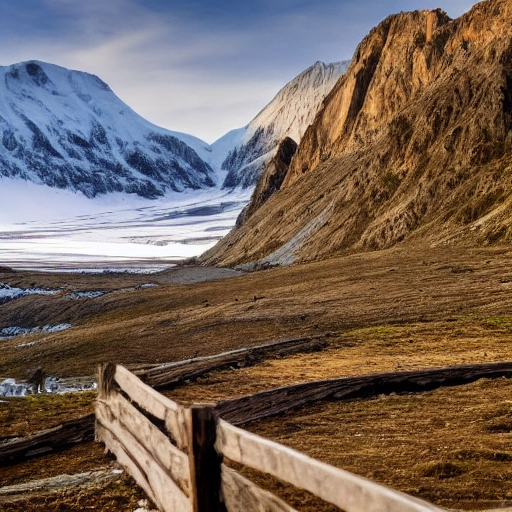

luxury bedroom interior


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/20 [00:00<?, ?it/s]

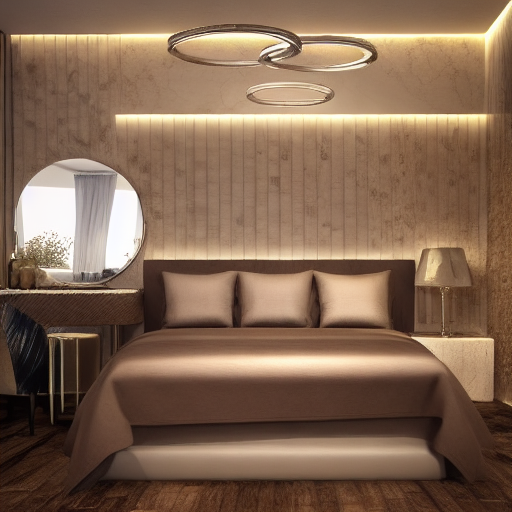

Beautiful snowy mountains


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/20 [00:00<?, ?it/s]

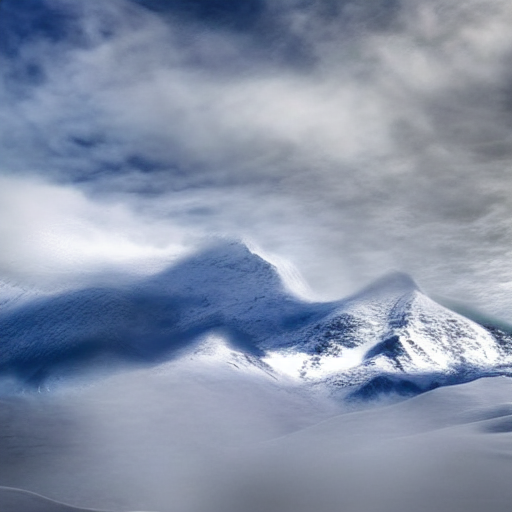

luxurious bedroom interior


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/20 [00:00<?, ?it/s]

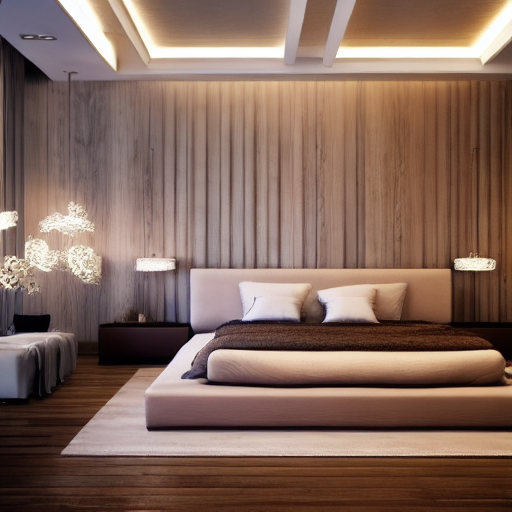

walls with cupboard


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/20 [00:00<?, ?it/s]

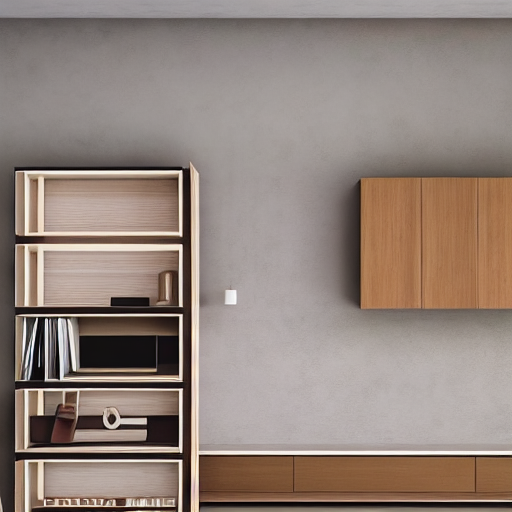

room with chair


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/20 [00:00<?, ?it/s]

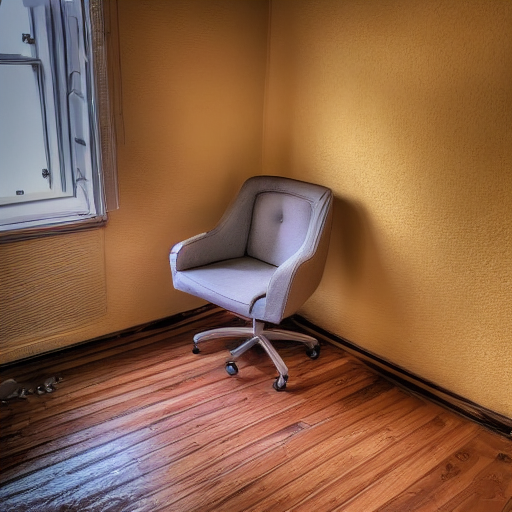

House in the forest


Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/20 [00:00<?, ?it/s]

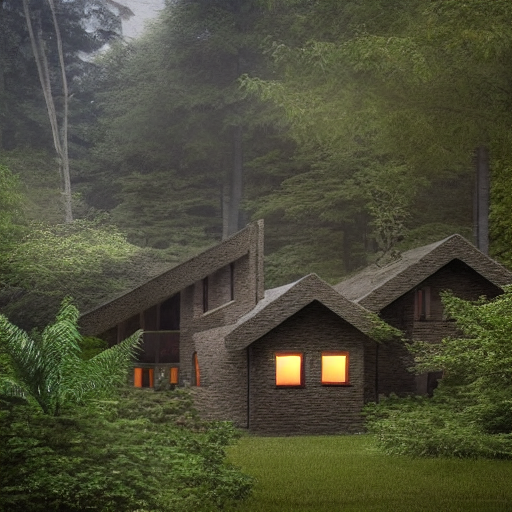

In [11]:
# Loop to generate images for all depth images and for different controlnet conditions
# For now I am generating and displaying only those with depth condition
for idx in range(7):
    prompt = prompt_list[idx]
    depth_img = load_depth_img(idx)
    for controlnet_condition in controlnet_model_dict.keys():
        # One can remove this condition to generate and display all images
        if(controlnet_condition == "depth"):
            print(prompt)
            gen_img = generate_image(idx,prompt,depth_img,controlnet_condition)[0]
            #gen_img.save("Results/Task1/"+str(idx+1)+"/"+controlnet_condition+"_"+str(controlnet_models_select)+".png")
            display(gen_img)

### Custom Normal Map and Canny Edge Experiment

In [12]:
# Function to create normal maps from depth images
def depth_to_normal(d_im):
    d_im = np.array(d_im)
    if(d_im.ndim == 3):
        # Convert RGB to BGR
        d_im = d_im[:, :, ::-1].copy()
        d_im = cv2.cvtColor(d_im, cv2.COLOR_BGR2GRAY)
    
    zy, zx = np.gradient(d_im)

    normal = np.dstack((-zx, -zy, np.ones_like(d_im)))
    n = np.linalg.norm(normal, axis=2)
    normal[:, :, 0] /= n
    normal[:, :, 1] /= n
    normal[:, :, 2] /= n
    # Map the normal vectors to the [0, 255] range and convert to uint8
    normal = (normal + 1) * 127.5
    normal = normal.clip(0, 255).astype(np.uint8)

    return Image.fromarray(normal)

In [17]:
# Function to create canny edges from depth images
def depth_to_canny(d_im):
    open_cv_image = np.array(d_im)
    
    # Setting parameter values 
    t_lower = 100 # Lower Threshold 
    t_upper = 200  # Upper threshold 
    
    # Applying the Canny Edge filter 
    edge = cv2.Canny(open_cv_image, t_lower, t_upper,apertureSize=5)
    edge = edge[:, :, None]
    edge = np.concatenate([edge, edge, edge], axis=2)
    
    return Image.fromarray(edge)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


beautiful landscape, mountains in the background


  0%|          | 0/20 [00:00<?, ?it/s]

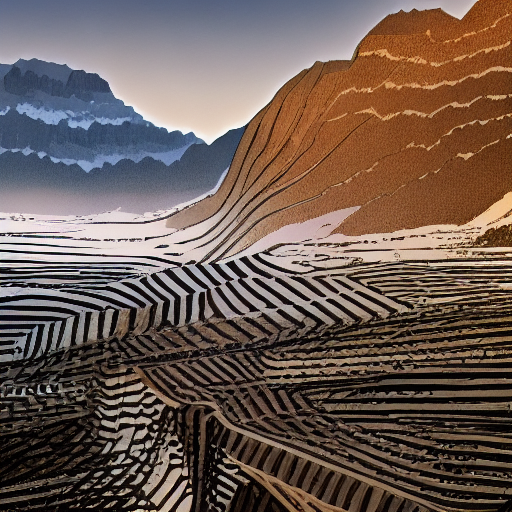

In [15]:
controlnet_mode = [controlnet_depth,controlnet_normal]
pipeline = create_pipeline(controlnet_mode)

for idx in range(7):
    prompt = prompt_list[idx]
    depth_img = load_depth_img(idx)
    #display(depth_img)

    normal_img = depth_to_normal(depth_img)
    #normal_img.save("Experiments/Normal_Maps/"+str(idx+1)+".png")
    #display(normal_img)

    generator = torch.Generator(device).manual_seed(12345)

    #one can remove this condition to generate and display for all images
    if(idx == 0):
        print(prompt)
        gen_img = pipeline(prompt, num_inference_steps=20, generator=generator, image=[depth_img,normal_img],height = 512, width =512).images[0]
        display(gen_img)
    #gen_img.save("Experiments/Normal_Maps/"+str(idx+1)+"_gen.png")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


beautiful landscape, mountains in the background


  0%|          | 0/20 [00:00<?, ?it/s]

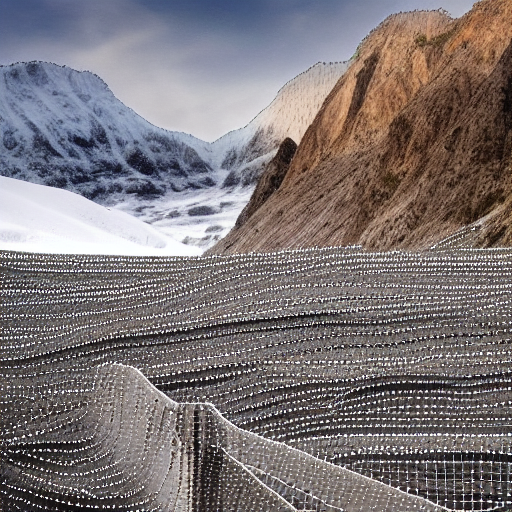

In [18]:
controlnet_mode = [controlnet_depth,controlnet_canny]
pipeline = create_pipeline(controlnet_mode)

for idx in range(7):
    prompt = prompt_list[idx]
    depth_img = load_depth_img(idx)
    #display(depth_img)
    
    canny_img = depth_to_canny(depth_img)
    #canny_img.save("Experiments/Canny_Edges/"+str(idx+1)+".png")
    #display(canny_img)

    generator = torch.Generator(device).manual_seed(12345)
    if(idx == 0):
        print(prompt)
        gen_img = pipeline(prompt, num_inference_steps=20, generator=generator, image=[depth_img,canny_img],height = 512, width =512).images[0]
        display(gen_img)
        #gen_img.save("Experiments/Canny_Edges/"+str(idx+1)+"_gen.png")
    

### Size Experiment

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/20 [00:00<?, ?it/s]

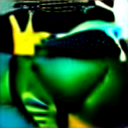

  0%|          | 0/20 [00:00<?, ?it/s]

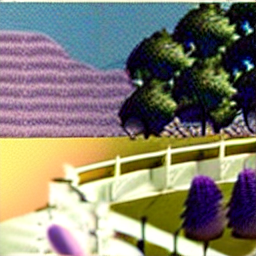

  0%|          | 0/20 [00:00<?, ?it/s]

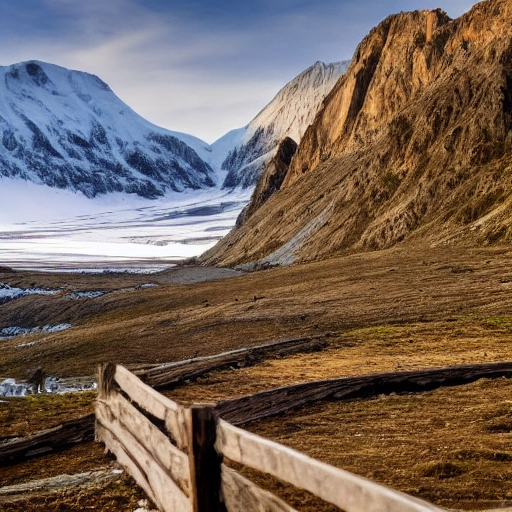

  0%|          | 0/20 [00:00<?, ?it/s]

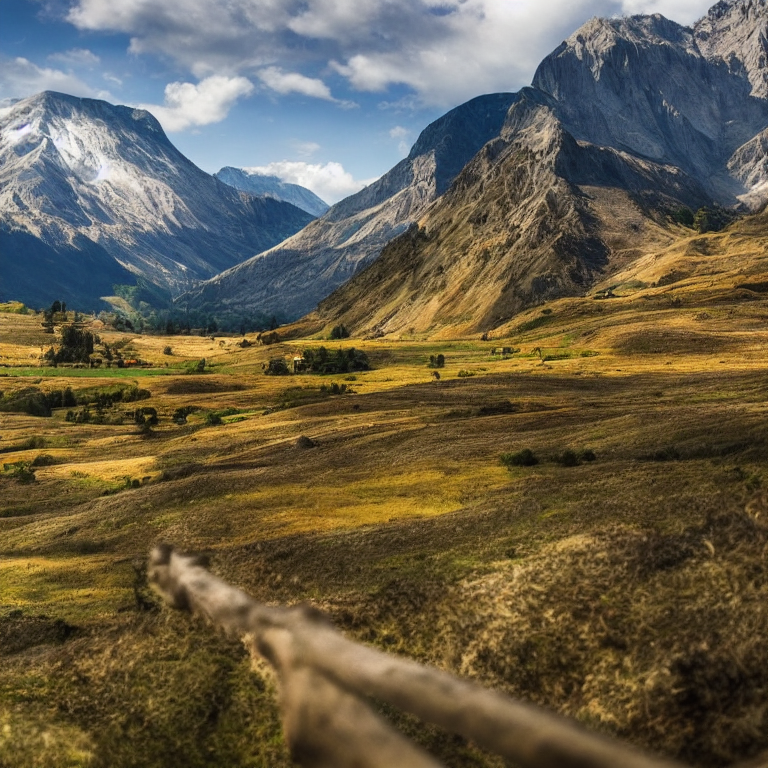

  0%|          | 0/20 [00:00<?, ?it/s]

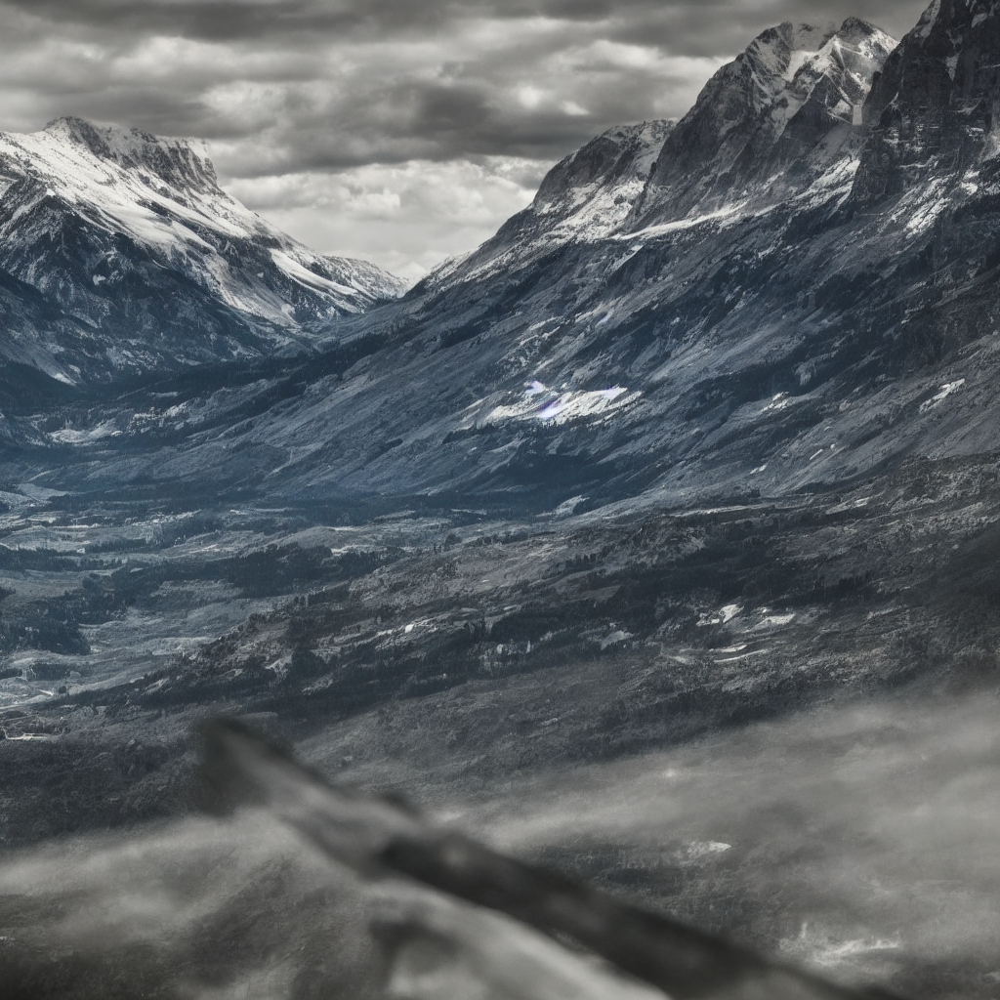

In [19]:
size_list = [128,256,512,768,1024]

controlnet_mode = controlnet_depth
pipeline = create_pipeline(controlnet_mode)

# only looping through the first image for now
for idx in range(1):
    prompt = prompt_list[idx]
    depth_img = load_depth_img(idx)
    for size in size_list:
        generator = torch.Generator(device).manual_seed(12345)
        gen_img = pipeline(prompt, num_inference_steps=20, generator=generator, image=depth_img,height = size, width = size).images[0]
        #gen_img.save("Experiments/Size/"+str(idx+1)+"/"+str(size)+".png")
        display(gen_img)

# Task 2

In [20]:
path = "Metadata/No Crop_/2_nocrop.png"
prompt = prompt_list[1]
depth_img = load_depth_img_from_path(path)
width, height = depth_img.size

print([width,height])
aspect_ratio = width/height
print("Original Aspect Ratio =",aspect_ratio)

[940, 564]
Original Aspect Ratio = 1.6666666666666667


In [21]:
# Let us try different aspect ratio starting with the original
aspect_ratio_w = [5,3,4,1,5,16]
aspect_ratio_h = [3,2,3,1,4,9]

# The actual widths and heights are calculated by keeping the aspect ratios same as defined above
actual_widths = [960,960,1024,960,960,1024]
actual_heights = [576,640,768,960,768,576]

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


  0%|          | 0/30 [00:00<?, ?it/s]

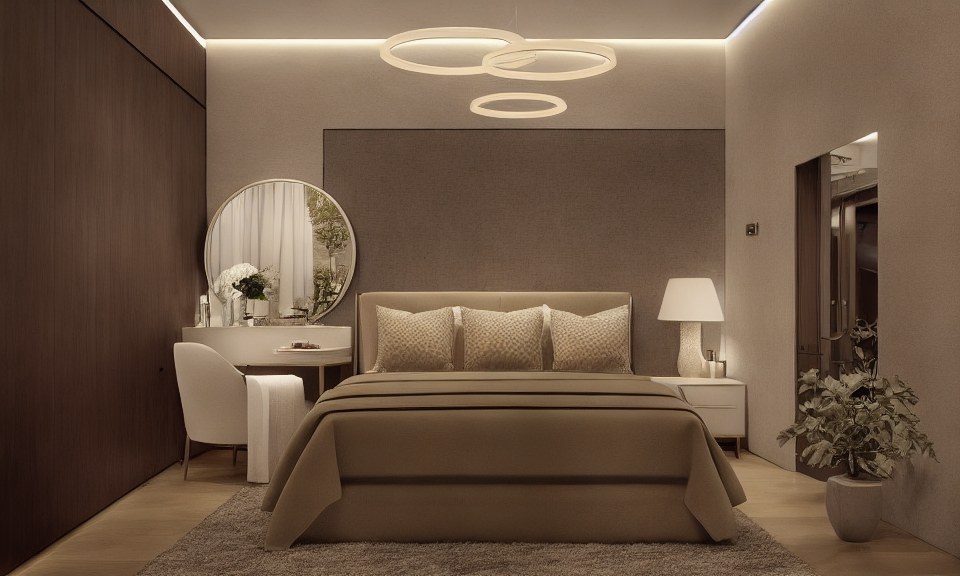

  0%|          | 0/30 [00:00<?, ?it/s]

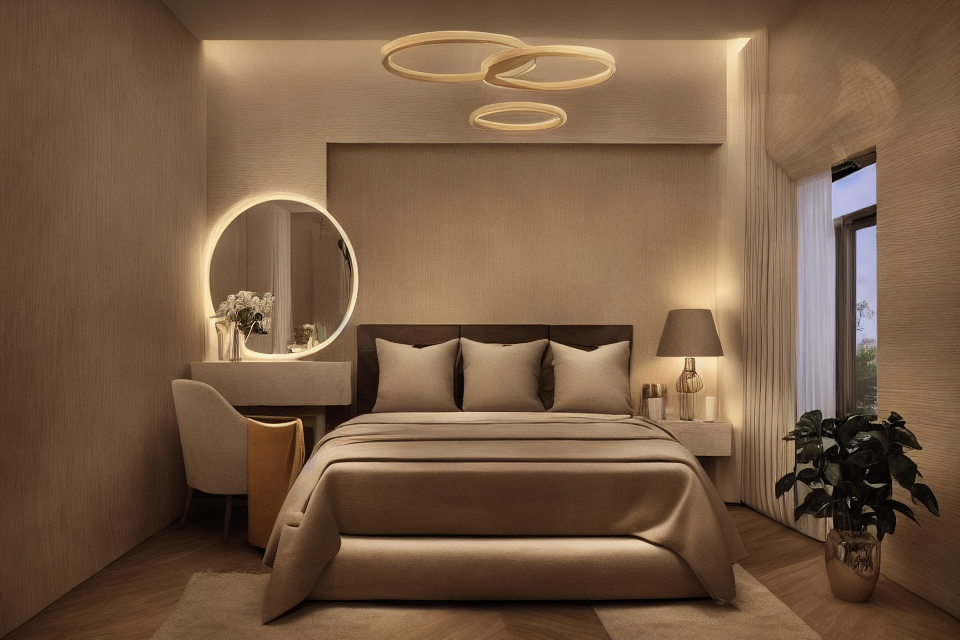

  0%|          | 0/30 [00:00<?, ?it/s]

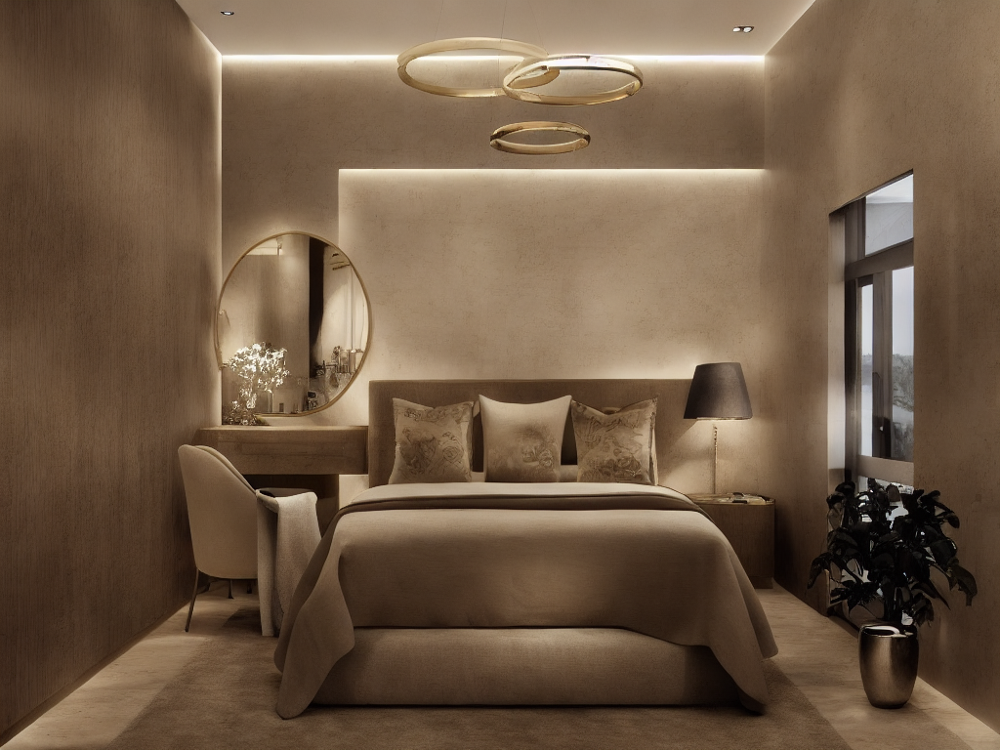

  0%|          | 0/30 [00:00<?, ?it/s]

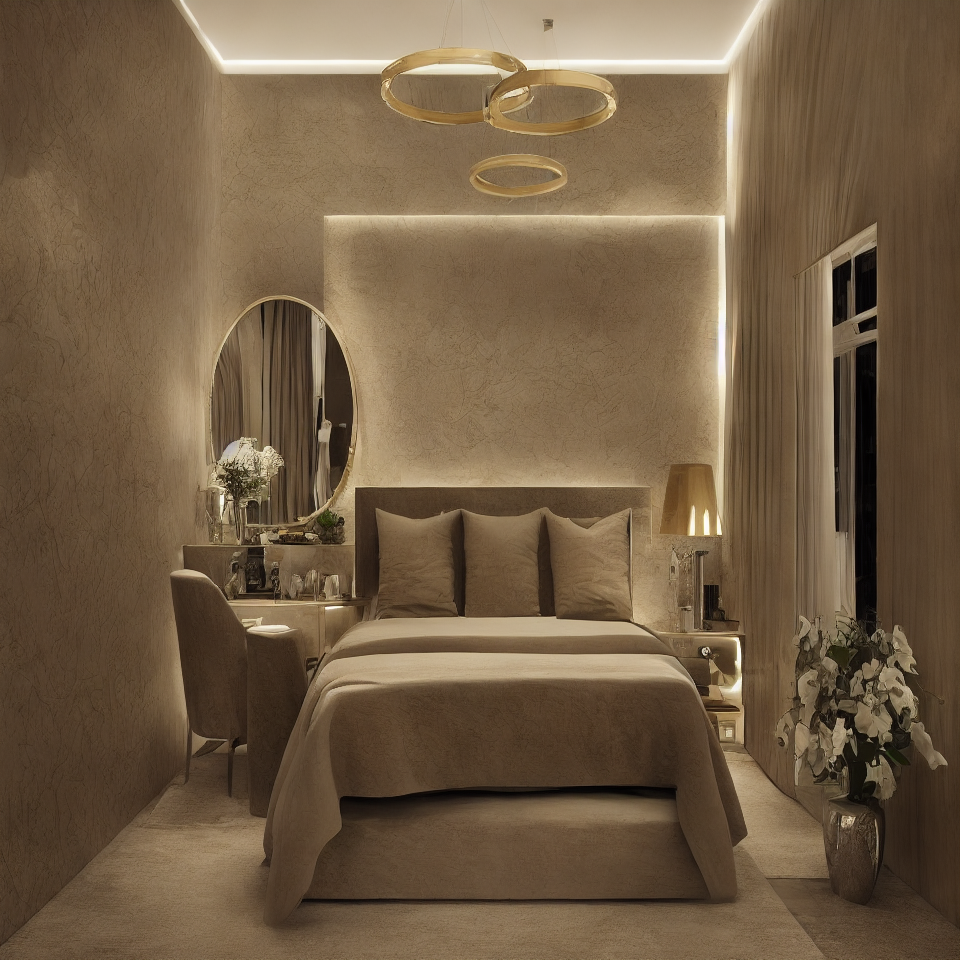

  0%|          | 0/30 [00:00<?, ?it/s]

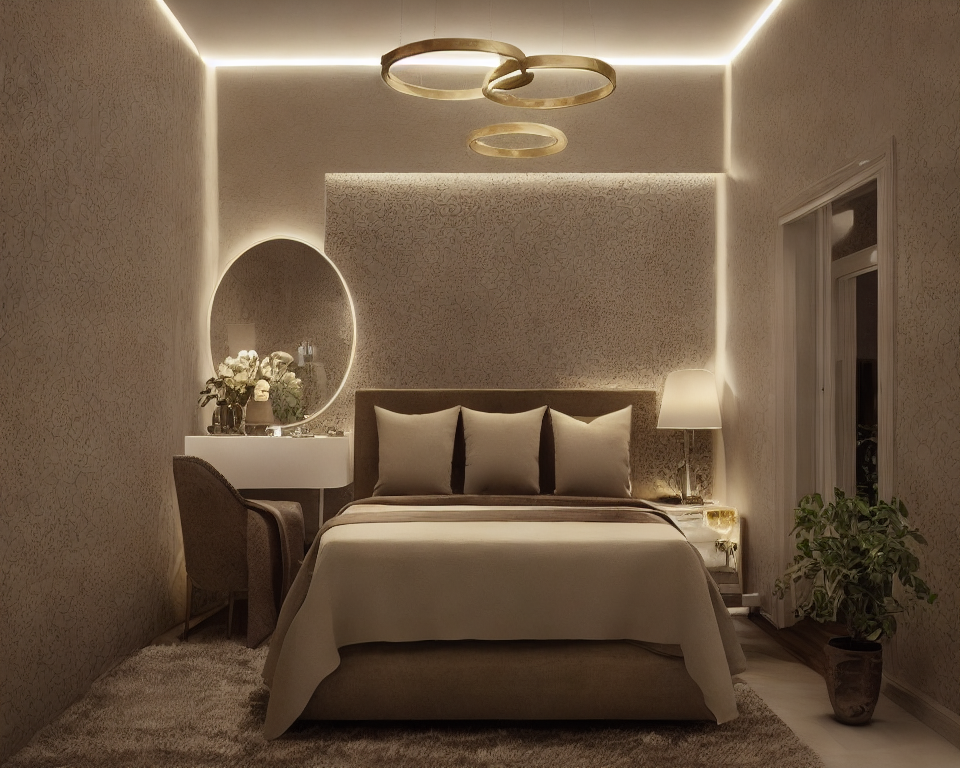

  0%|          | 0/30 [00:00<?, ?it/s]

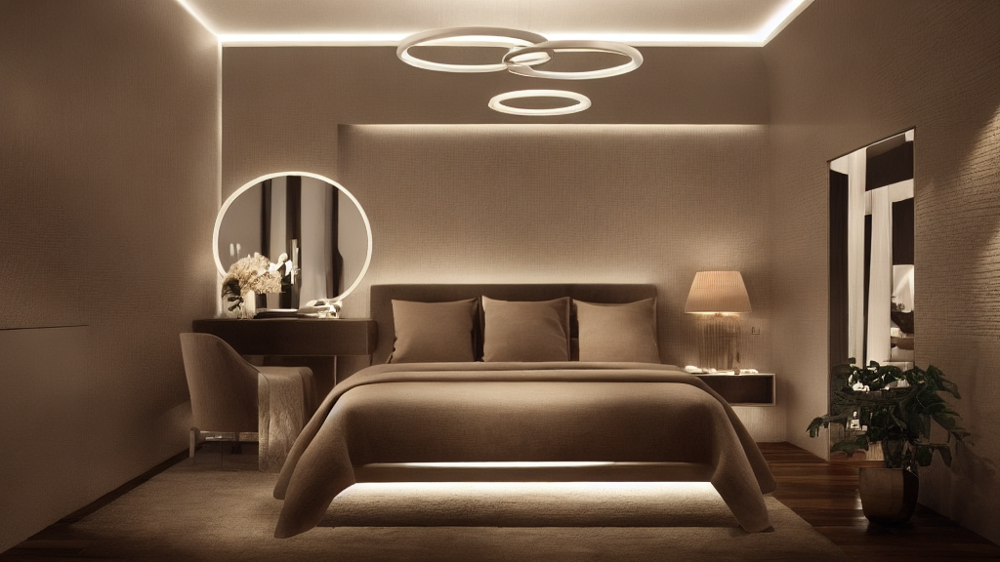

In [13]:
controlnet_mode = controlnet_depth
pipeline = create_pipeline(controlnet_mode)

for resolution_idx in range(len(actual_widths)):
    width = actual_widths[resolution_idx]
    height = actual_heights[resolution_idx]
    generator = torch.Generator(device).manual_seed(12345)
    gen_img = pipeline(prompt, num_inference_steps=30, generator=generator, image=depth_img,height = height, width = width).images[0]
    #gen_img.save("Results/No_Crop/"+str(width)+"x"+str(height)+".png")
    display(gen_img)

# Task 3

Lets establish a baseline generation latency first with the 7th depth image

In [22]:
idx = 6
prompt = prompt_list[idx]
depth_img = load_depth_img(idx)
pipeline = create_pipeline(controlnet_depth)

  0%|          | 0/20 [00:00<?, ?it/s]

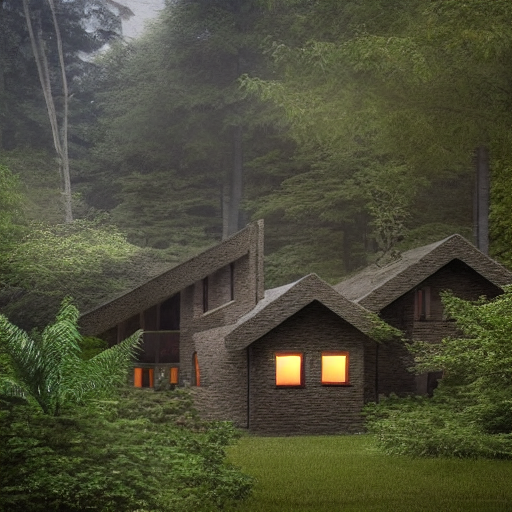

Time to generate the above image =  8.088476657867432 s


In [24]:
# Setting the seed of the generator
generator = torch.Generator(device).manual_seed(12345)

start = time.time()
gen_img = pipeline(prompt, num_inference_steps=20, generator=generator, image=depth_img,height=512,width=512).images[0]
end = time.time()

display(gen_img)

time_to_generate = end - start
print("Time to generate the above image = ",time_to_generate,"s")

In [25]:
for num_steps in [1,2,3,5,8,10,12,15,18,20]:
    generator = torch.Generator(device).manual_seed(12345)
    start = time.time()
    gen_img = pipeline(prompt, num_inference_steps=num_steps, generator=generator, image=depth_img,height=512,width=512).images[0]
    end = time.time()
    #gen_img.save("Results/Task3/Inference_Steps/"+str(num_steps)+".png")
    # display(gen_img)
    time_to_generate = end - start
    print("Time to generate image with " + str(num_steps) +" inference steps = ",time_to_generate,"s")

  0%|          | 0/1 [00:00<?, ?it/s]

Time to generate image with 1 inference steps =  2.69819712638855 s


  0%|          | 0/2 [00:00<?, ?it/s]

Time to generate image with 2 inference steps =  2.476093053817749 s


  0%|          | 0/3 [00:00<?, ?it/s]

Time to generate image with 3 inference steps =  2.8768560886383057 s


  0%|          | 0/5 [00:00<?, ?it/s]

Time to generate image with 5 inference steps =  4.089348077774048 s


  0%|          | 0/8 [00:00<?, ?it/s]

Time to generate image with 8 inference steps =  4.7906458377838135 s


  0%|          | 0/10 [00:00<?, ?it/s]

Time to generate image with 10 inference steps =  5.470438718795776 s


  0%|          | 0/12 [00:00<?, ?it/s]

Time to generate image with 12 inference steps =  6.5997154712677 s


  0%|          | 0/15 [00:00<?, ?it/s]

Time to generate image with 15 inference steps =  7.889076232910156 s


  0%|          | 0/18 [00:00<?, ?it/s]

Time to generate image with 18 inference steps =  8.20624566078186 s


  0%|          | 0/20 [00:00<?, ?it/s]

Time to generate image with 20 inference steps =  9.620546340942383 s


### Deep Cache

In [30]:
from DeepCache import DeepCacheSDHelper
helper = DeepCacheSDHelper(pipe=pipeline)
helper.set_params(cache_interval=3,cache_branch_id=0,)
helper.enable()

  0%|          | 0/10 [00:00<?, ?it/s]

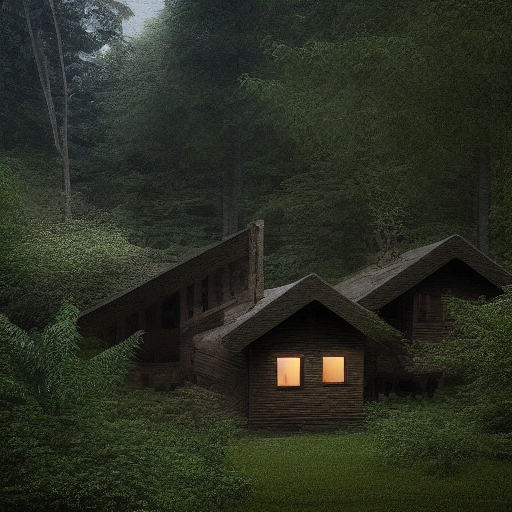

Time to generate the above image =  4.099691152572632 s


In [31]:
# Setting the seed of the generator
generator = torch.Generator(device).manual_seed(12345)

start = time.time()
gen_img = pipeline(prompt, num_inference_steps=10, generator=generator, image=depth_img,height=512,width=512).images[0]
end = time.time()

gen_img.save("Results/Task3/DeepCache/DeepCache.png")
display(gen_img)

time_to_generate = end - start
print("Time to generate the above image = ",time_to_generate,"s")

### Trying different schedulers

In [26]:
from diffusers import UniPCMultistepScheduler, DDIMScheduler, PNDMScheduler, LMSDiscreteScheduler, EulerDiscreteScheduler, EulerAncestralDiscreteScheduler, DPMSolverMultistepScheduler  
# set scheduler
prompt = prompt_list[6]
pipeline = StableDiffusionControlNetPipeline.from_pretrained("runwayml/stable-diffusion-v1-5",controlnet = controlnet_depth, safety_checker=None,torch_dtype = torch.float16)

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.controlnet.pipeline_controlnet.StableDiffusionControlNetPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


In [27]:
pipeline.scheduler = DPMSolverMultistepScheduler.from_config(pipeline.scheduler.config)
pipeline.enable_xformers_memory_efficient_attention()
pipeline.enable_model_cpu_offload()

  0%|          | 0/10 [00:00<?, ?it/s]

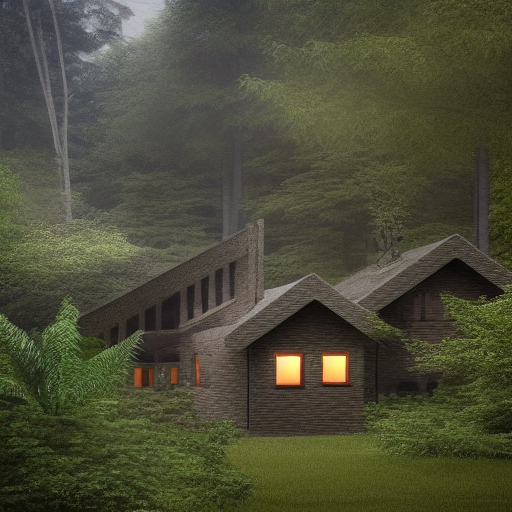

Time to generate the above image =  5.065548896789551 s


In [29]:
generator = torch.Generator(device).manual_seed(12345)
start = time.time()
gen_img = pipeline(prompt=prompt, num_inference_steps=10, image=depth_img, generator=generator,height=512,width=512).images[0]
end = time.time()

#gen_img.save("Results/Task3/Schedulers/DPMSolverMultistep.png")
display(gen_img)
time_to_generate = end - start
print("Time to generate the above image = ",time_to_generate,"s")

In [16]:
torch._inductor.config.conv_1x1_as_mm = True
torch._inductor.config.coordinate_descent_tuning = True
torch._inductor.config.epilogue_fusion = False
torch._inductor.config.coordinate_descent_check_all_directions = True

pipeline.fuse_qkv_projections()

pipeline.unet.to(memory_format=torch.channels_last)
pipeline.vae.to(memory_format=torch.channels_last)

# Compile the UNet and VAE.
pipeline.unet = torch.compile(pipeline.unet, mode="max-autotune", fullgraph=True)
pipeline.vae.decode = torch.compile(pipeline.vae.decode, mode="max-autotune", fullgraph=True)
# Setting the seed of the generator
generator = torch.Generator(device).manual_seed(12345)

start = time.time()
gen_img = pipeline(prompt, num_inference_steps=20, generator=generator, image=depth_img,height=512,width=512).images[0]
end = time.time()
display(gen_img)
time_to_generate = end - start
print("Time to generate the above image = ",time_to_generate,"s")

AttributeError: 'function' object has no attribute 'fuse_qkv_projections'